In [69]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [70]:
from tensorflow.keras.preprocessing.image import ImageDataGenerator # Correct import path
from matplotlib import pyplot as plt
import numpy as np
def aumentarImagenes(img_array,n,plotear=False):

  img_array = np.expand_dims(img_array, axis=0)  # Agrega una dimensión para el batch

# Crea un generador de aumento de datos
  datagen = ImageDataGenerator(
    rotation_range=40,
    width_shift_range=0.2,
    height_shift_range=0.2,
    shear_range=0.2,
    zoom_range=0.2,
    horizontal_flip=True,
    fill_mode='nearest'
)

# Genera imágenes aumentadas
  i = 0
  images = []
  for batch in datagen.flow(img_array, batch_size=1):
    # Muestra o guarda la imagen aumentada
    if plotear:
      plt.figure(i)
      plt.imshow(batch[0])
    images.append(batch[0])
    i += 1
    if i > n:  # Genera 5 imágenes aumentadas
      break
  if plotear:
    plt.show()

  return images


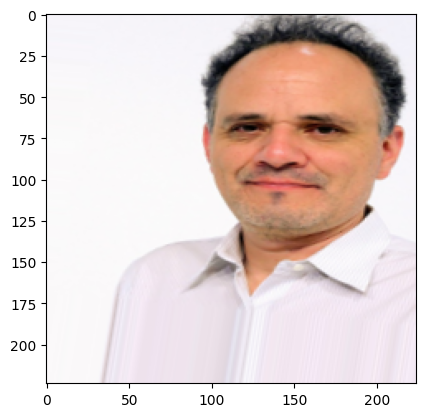

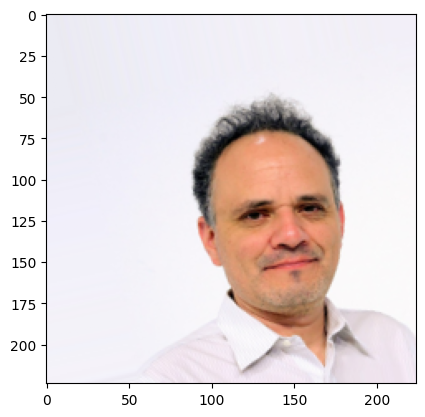

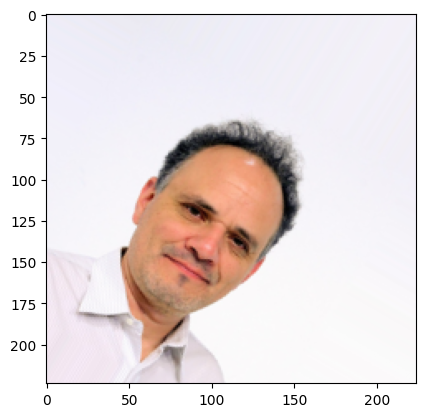

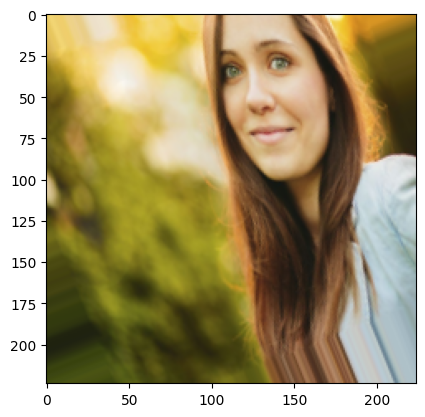

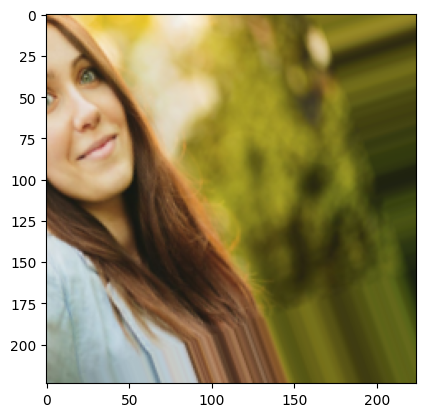

...

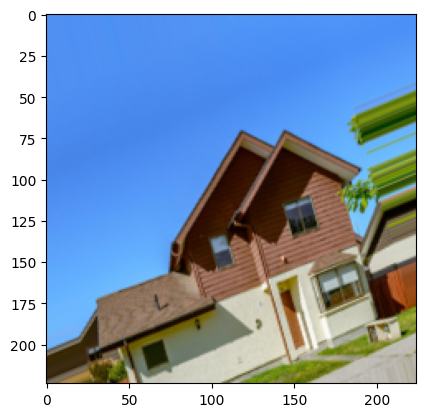

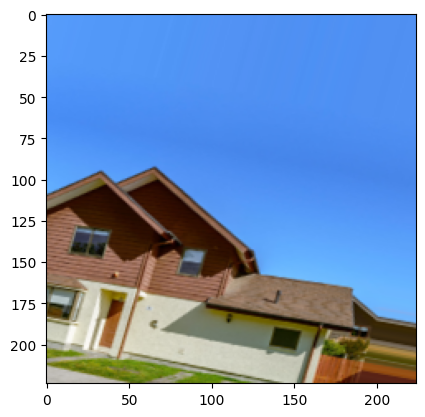

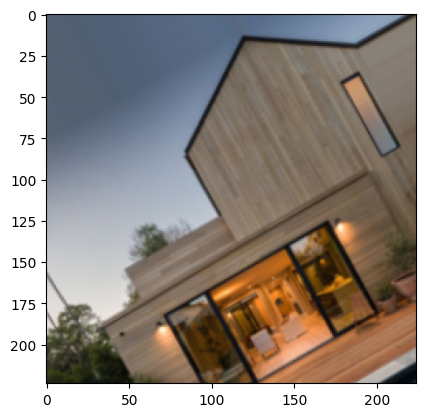

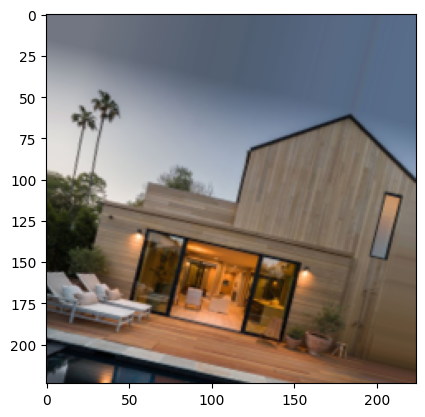

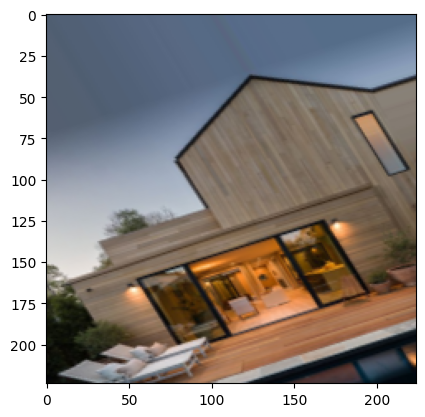

In [71]:
#Carga de librerias
from PIL import Image
import os
import numpy as np

# Ruta a la carpeta que contiene las imágenes
folder_path = '/content/drive/My Drive/perros/Todo'

# Lista para almacenar las imágenes cargadas
image_list = []
#Lista para almacenar las etiquetas
y = []
# Recorre todos los archivos en la carpeta
val = -1
for filename in os.listdir(folder_path):
    if 'perro' in filename:
      y.append(0) #indice 0 perro [perro,persona,casa]
      val = 0
    elif 'persona' in filename: #indice 1 persona
      y.append(1)
      val = 1
    elif 'casa' in filename: #indice 2 casa
      y.append(2)
      val = 2
    if filename.endswith(".jpg") or filename.endswith(".png"):
        img_path = os.path.join(folder_path, filename)
        img = Image.open(img_path)
        img = img.resize((224, 224))  # Redimensiona la imagen
        img_array = np.array(img) / 255.0  # Normaliza los valores de píxeles
        image_list.append(img_array)
        aumentadas = aumentarImagenes(img_array,2,True)
        image_list.extend(aumentadas)
        for i in range(len(aumentadas)):
          y.append(val)


# Ahora 'image_list_train' contiene todas las imágenes cargadas


In [72]:
from sklearn.model_selection import train_test_split
X_train, X_test, y_train, y_test = train_test_split(image_list, y, test_size=0.2, random_state=42, stratify=y)

In [73]:
#Carga de librerias
import keras
from keras.models import Sequential
from keras.layers import Dense, Flatten
#Se establece una semilla para evitar distintos resultados
keras.utils.set_random_seed(20)#812
#Se establece un modelo neuronal
model = Sequential()
model.add(Flatten(input_shape=(224, 224, 3)))  # Aplanar la imagen
model.add(Dense(128, activation='relu'))
model.add(Dense(64, activation='relu'))
model.add(Dense(3, activation='softmax')) #3 es el numero de clases

/usr/local/lib/python3.10/dist-packages/keras/src/layers/reshaping/flatten.py:37: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


In [74]:
#Se compila el modelo
model.compile(optimizer='adam', loss='categorical_crossentropy', metrics=['accuracy'])

In [75]:
#model.save('modelo_perros.h5')

In [76]:
#Verificamos la estructura de salida esperada para entrenamiento
y_train

[1,
 2,
 0,
 0,
 0,
 1,
 1,
 2,
 1,
 0,
 1,
 1,
 1,
 0,
 0,
 0,
 0,
 2,
 2,
 0,
 0,
 0,
 2,
 0,
 1,
 0,
 2,
 0,
 2,
 0,
 1,
 1,
 1,
 2,
 2,
 2,
 1,
 0,
 1,
 1,
 0,
 2,
 0,
 1,
 1,
 1,
 2,
 2,
 0,
 2,
 2,
 2,
 0,
 0,
 2,
 2,
 0,
 2,
 1,
 2,
 1,
 2,
 2,
 2,
 1,
 2,
 2,
 1,
 2,
 0,
 1,
 2,
 2,
 0,
 1,
 1,
 1,
 2,
 1,
 0,
 1,
 2,
 0,
 0,
 0,
 0,
 1,
 2,
 0,
 0,
 1,
 1,
 1,
 2,
 1,
 2,
 0,
 2,
 0,
 0,
 0,
 2,
 0,
 0,
 0]

In [77]:
#Cambiamos la forma
X_train = np.array(X_train)
y_train = np.array(y_train)

In [78]:
y_train = keras.utils.to_categorical(y_train, num_classes=3)
y_train

array([[0., 1., 0.],
       [0., 0., 1.],
       [1., 0., 0.],
       [1., 0., 0.],
       [1., 0., 0.],
       [0., 1., 0.],
       [0., 1., 0.],
       [0., 0., 1.],
       [0., 1., 0.],
       [1., 0., 0.],
       [0., 1., 0.],
       [0., 1., 0.],
       [0., 1., 0.],
       [1., 0., 0.],
       [1., 0., 0.],
       [1., 0., 0.],
       [1., 0., 0.],
       [0., 0., 1.],
       [0., 0., 1.],
       [1., 0., 0.],
       [1., 0., 0.],
       [1., 0., 0.],
       [0., 0., 1.],
       [1., 0., 0.],
       [0., 1., 0.],
       [1., 0., 0.],
       [0., 0., 1.],
       [1., 0., 0.],
       [0., 0., 1.],
       [1., 0., 0.],
       [0., 1., 0.],
       [0., 1., 0.],
       [0., 1., 0.],
       [0., 0., 1.],
       [0., 0., 1.],
       [0., 0., 1.],
       [0., 1., 0.],
       [1., 0., 0.],
       [0., 1., 0.],
       [0., 1., 0.],
       [1., 0., 0.],
       [0., 0., 1.],
       [1., 0., 0.],
       [0., 1., 0.],
       [0., 1., 0.],
       [0., 1., 0.],
       [0., 0., 1.],
       [0., 0

In [79]:
X_train.shape

(105, 224, 224, 3)

In [80]:
#Verificamos el cambio
y_train

array([[0., 1., 0.],
       [0., 0., 1.],
       [1., 0., 0.],
       [1., 0., 0.],
       [1., 0., 0.],
       [0., 1., 0.],
       [0., 1., 0.],
       [0., 0., 1.],
       [0., 1., 0.],
       [1., 0., 0.],
       [0., 1., 0.],
       [0., 1., 0.],
       [0., 1., 0.],
       [1., 0., 0.],
       [1., 0., 0.],
       [1., 0., 0.],
       [1., 0., 0.],
       [0., 0., 1.],
       [0., 0., 1.],
       [1., 0., 0.],
       [1., 0., 0.],
       [1., 0., 0.],
       [0., 0., 1.],
       [1., 0., 0.],
       [0., 1., 0.],
       [1., 0., 0.],
       [0., 0., 1.],
       [1., 0., 0.],
       [0., 0., 1.],
       [1., 0., 0.],
       [0., 1., 0.],
       [0., 1., 0.],
       [0., 1., 0.],
       [0., 0., 1.],
       [0., 0., 1.],
       [0., 0., 1.],
       [0., 1., 0.],
       [1., 0., 0.],
       [0., 1., 0.],
       [0., 1., 0.],
       [1., 0., 0.],
       [0., 0., 1.],
       [1., 0., 0.],
       [0., 1., 0.],
       [0., 1., 0.],
       [0., 1., 0.],
       [0., 0., 1.],
       [0., 0

In [81]:
type(y_train)

numpy.ndarray

In [82]:
y_train.shape

(105, 3)

In [83]:
#Ajustamos("Entrenamos") el modelo al conjunto de datos
%time model.fit(X_train,y_train,epochs=200)

Epoch 1/200
4/4 ━━━━━━━━━━━━━━━━━━━━ 3s 306ms/step - accuracy: 0.3288 - loss: 19.5674
Epoch 2/200
4/4 ━━━━━━━━━━━━━━━━━━━━ 1s 308ms/step - accuracy: 0.5273 - loss: 11.4561
Epoch 3/200
4/4 ━━━━━━━━━━━━━━━━━━━━ 2s 279ms/step - accuracy: 0.6338 - loss: 3.1802
Epoch 4/200
4/4 ━━━━━━━━━━━━━━━━━━━━ 1s 288ms/step - accuracy: 0.4624 - loss: 7.6279
Epoch 5/200
4/4 ━━━━━━━━━━━━━━━━━━━━ 1s 335ms/step - accuracy: 0.5387 - loss: 10.9010
Epoch 6/200
4/4 ━━━━━━━━━━━━━━━━━━━━ 2s 376ms/step - accuracy: 0.6865 - loss: 4.1805
Epoch 7/200
4/4 ━━━━━━━━━━━━━━━━━━━━ 3s 399ms/step - accuracy: 0.6701 - loss: 7.1291
Epoch 8/200
4/4 ━━━━━━━━━━━━━━━━━━━━ 2s 279ms/step - accuracy: 0.6104 - loss: 7.1382
Epoch 9/200
4/4 ━━━━━━━━━━━━━━━━━━━━ 1s 274ms/step - accuracy: 0.7464 - loss: 3.6643
Epoch 10/200
4/4 ━━━━━━━━━━━━━━━━━━━━ 1s 266ms/step - accuracy: 0.7266 - loss: 3.8005
Epoch 11/200
4/4 ━━━━━━━━━━━━━━━━━━━━ 1s 278ms/step - accuracy: 0.8096 - loss: 2.3092
Epoch 12/200
4/4 ━━━━━━━━━━━━━━━━━━━━ 1s 263ms/step - accura

In [84]:
%time y_train

CPU times: user 3 µs, sys: 1e+03 ns, total: 4 µs
Wall time: 8.82 µs


array([[0., 1., 0.],
       [0., 0., 1.],
       [1., 0., 0.],
       [1., 0., 0.],
       [1., 0., 0.],
       [0., 1., 0.],
       [0., 1., 0.],
       [0., 0., 1.],
       [0., 1., 0.],
       [1., 0., 0.],
       [0., 1., 0.],
       [0., 1., 0.],
       [0., 1., 0.],
       [1., 0., 0.],
       [1., 0., 0.],
       [1., 0., 0.],
       [1., 0., 0.],
       [0., 0., 1.],
       [0., 0., 1.],
       [1., 0., 0.],
       [1., 0., 0.],
       [1., 0., 0.],
       [0., 0., 1.],
       [1., 0., 0.],
       [0., 1., 0.],
       [1., 0., 0.],
       [0., 0., 1.],
       [1., 0., 0.],
       [0., 0., 1.],
       [1., 0., 0.],
       [0., 1., 0.],
       [0., 1., 0.],
       [0., 1., 0.],
       [0., 0., 1.],
       [0., 0., 1.],
       [0., 0., 1.],
       [0., 1., 0.],
       [1., 0., 0.],
       [0., 1., 0.],
       [0., 1., 0.],
       [1., 0., 0.],
       [0., 0., 1.],
       [1., 0., 0.],
       [0., 1., 0.],
       [0., 1., 0.],
       [0., 1., 0.],
       [0., 0., 1.],
       [0., 0

In [85]:
#Cambiamos el formato al conjunto de prueba
X_test = np.array(X_test)
y_test = np.array(y_test)

In [86]:
if len(y_test.shape) == 0:
    y_test = y_test.reshape(1,)

In [87]:
print(y_test.shape)
print(X_test.shape)

(27,)
(27, 224, 224, 3)


In [88]:
#Verificamos su forma
y_test

array([1, 0, 0, 2, 1, 1, 0, 1, 0, 0, 2, 0, 1, 2, 1, 1, 2, 2, 1, 2, 0, 0,
       0, 2, 0, 2, 2])

In [89]:
#Usamos el modelo para predecir con el conjunto de prueba
y_pred = model.predict(X_test) #Esto genera una salida predicha

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


In [90]:
#Revisamos el resultado
y_pred

array([[1.8643352e-06, 9.9999803e-01, 8.9789917e-29],
       [9.9999994e-01, 1.2880521e-09, 0.0000000e+00],
       [6.7067161e-02, 9.3293297e-01, 1.0995931e-11],
       [9.3915248e-03, 6.0930539e-05, 9.9054742e-01],
       [4.2563084e-01, 5.7436907e-01, 2.4100616e-15],
       [3.7555650e-02, 9.6244431e-01, 4.1787714e-22],
       [9.9999994e-01, 2.7953804e-17, 2.3107404e-19],
       [1.8000886e-10, 9.9999994e-01, 6.5458204e-36],
       [9.9065965e-01, 2.1501764e-05, 9.3189795e-03],
       [9.9999982e-01, 1.5543468e-07, 1.3841228e-09],
       [5.4423082e-01, 6.7056777e-13, 4.5576906e-01],
       [9.9999958e-01, 3.3080204e-07, 5.0523177e-09],
       [2.4110335e-04, 9.9975896e-01, 8.8646652e-33],
       [3.0575251e-10, 2.4738742e-13, 9.9999994e-01],
       [8.8804280e-19, 3.1205558e-03, 9.9687940e-01],
       [5.7169574e-04, 9.9942839e-01, 1.0322256e-12],
       [3.5200112e-05, 9.9491644e-01, 5.0483900e-03],
       [7.1489150e-23, 7.9977554e-18, 9.9999994e-01],
       [3.1488096e-18, 9.999

In [91]:
#Redondeamos los resultados
y_pred=np.round(y_pred)
y_pred

array([[0., 1., 0.],
       [1., 0., 0.],
       [0., 1., 0.],
       [0., 0., 1.],
       [0., 1., 0.],
       [0., 1., 0.],
       [1., 0., 0.],
       [0., 1., 0.],
       [1., 0., 0.],
       [1., 0., 0.],
       [1., 0., 0.],
       [1., 0., 0.],
       [0., 1., 0.],
       [0., 0., 1.],
       [0., 0., 1.],
       [0., 1., 0.],
       [0., 1., 0.],
       [0., 0., 1.],
       [0., 1., 0.],
       [0., 1., 0.],
       [0., 1., 0.],
       [1., 0., 0.],
       [1., 0., 0.],
       [0., 0., 1.],
       [1., 0., 0.],
       [1., 0., 0.],
       [0., 0., 1.]], dtype=float32)

In [92]:
#Se importan las librerias

import pandas as pd
from sklearn.metrics import confusion_matrix, accuracy_score, precision_score, recall_score, f1_score, roc_auc_score, mean_absolute_error, mean_squared_error, r2_score


y_pred = np.argmax(y_pred, axis=1)
# Accuracy
# Métricas de clasificación
conf_matrix = confusion_matrix(y_test, y_pred)
accuracy = accuracy_score(y_test, y_pred)

# Calculamos precision, recall y f1 para cada clase
precision = precision_score(y_test, y_pred, average=None)
precision_avg = precision_score(y_test, y_pred, average="macro")
recall = recall_score(y_test, y_pred, average=None)
recall_avg = recall_score(y_test, y_pred, average="macro")
f1 = f1_score(y_test, y_pred, average=None)
f1_avg = f1_score(y_test, y_pred, average="macro")
print("Exactitud:", accuracy)
print("Precisión por clase:", precision,'->', precision_avg)
print("Sensibilidad por clase:", recall,'->', recall_avg)
print("F1 Score por clase:", f1,'->', f1_avg)

Exactitud: 0.7407407407407407
Precisión por clase: [0.8        0.63636364 0.83333333] -> 0.7565656565656567
Sensibilidad por clase: [0.8        0.875      0.55555556] -> 0.7435185185185186
F1 Score por clase: [0.8        0.73684211 0.66666667] -> 0.7345029239766082


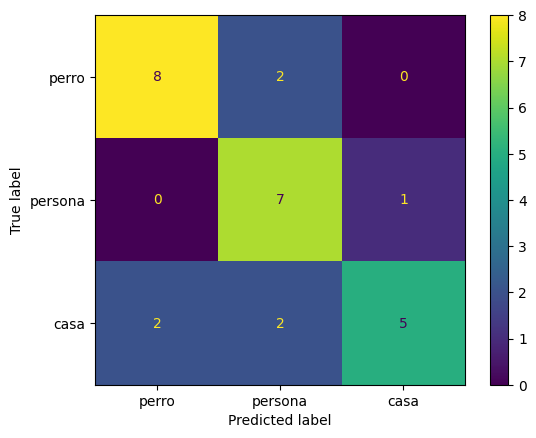

In [93]:
from sklearn.metrics import ConfusionMatrixDisplay
cm = confusion_matrix(y_test, y_pred)
disp = ConfusionMatrixDisplay(confusion_matrix=cm)
disp.display_labels = ['perro','persona','casa']
disp.plot()

In [94]:
y_test

array([1, 0, 0, 2, 1, 1, 0, 1, 0, 0, 2, 0, 1, 2, 1, 1, 2, 2, 1, 2, 0, 0,
       0, 2, 0, 2, 2])

In [95]:
y_pred

array([1, 0, 1, 2, 1, 1, 0, 1, 0, 0, 0, 0, 1, 2, 2, 1, 1, 2, 1, 1, 1, 0,
       0, 2, 0, 0, 2])

In [96]:
X_test[5]

array([[[1.        , 1.        , 1.        ],
        [1.        , 1.        , 1.        ],
        [1.        , 1.        , 1.        ],
        ...,
        [1.        , 1.        , 1.        ],
        [1.        , 1.        , 1.        ],
        [1.        , 1.        , 1.        ]],

       [[1.        , 1.        , 1.        ],
        [1.        , 1.        , 1.        ],
        [1.        , 1.        , 1.        ],
        ...,
        [1.        , 1.        , 1.        ],
        [1.        , 1.        , 1.        ],
        [1.        , 1.        , 1.        ]],

       [[1.        , 1.        , 1.        ],
        [1.        , 1.        , 1.        ],
        [1.        , 1.        , 1.        ],
        ...,
        [1.        , 1.        , 1.        ],
        [1.        , 1.        , 1.        ],
        [1.        , 1.        , 1.        ]],

       ...,

       [[0.45975605, 0.47782105, 0.45736614],
        [0.88248056, 0.9070884 , 0.88312477],
        [0.79124874, 0

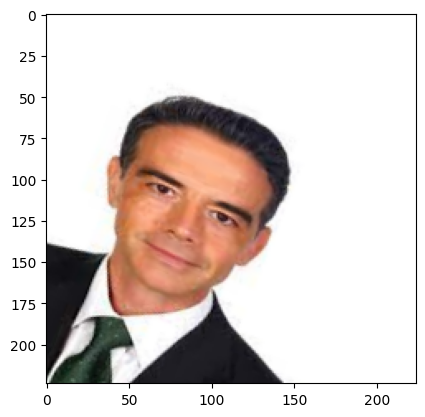

In [97]:
import matplotlib.pyplot as plt
img_array = (X_test[5] * 255).astype(np.uint8)  # Scale to 0-255 and convert to 8-bit integer
img = Image.fromarray(img_array)
plt.imshow(img)